# Ford GoBike Bike Trips in San Francisco Dataset in February 2019
## by Fatema Mahmoud

## Investigation Overview

- When are most trips taken in terms of time of day and day of the week?
- How long does the average trip take?
- And whether all the phenomena above depends on whether the user is customer or subscriber, their gender, or their age?


## Dataset Overview

- The data consists of 183412 rows and 19 columns.
- It has about 5 categorical data and 4 quantitative data.

In [1]:
# import all packages and set plots to be embedded inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sb

%matplotlib inline

# suppress warnings from final output
import warnings
warnings.simplefilter("ignore")

In [2]:
# load in the dataset into a pandas dataframe
df = pd.read_csv('201902-fordgobike-tripdata-clean-version.csv')

> Note that the above cells have been set as "Skip"-type slides. That means
that when the notebook is rendered as http slides, those cells won't show up.

## Users' Age, Gender, and  Type

- The dataset contains many males than females, and more subscribers than customers.
- The distribution of users' age is right skewed. The majority of users' birth is between 1979 (~ 41 years old) and 1997 (~ 22 years old).

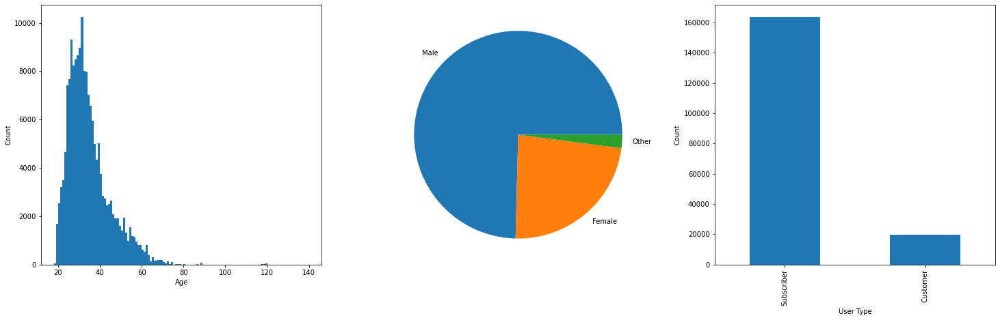

In [3]:
plt.figure(figsize=[25, 7])

plt.subplot(1, 3, 1)

bins = np.arange(df['age'].min(), df['age'].max())

plt.hist(df['age'], bins = bins);
plt.xlabel('Age');
plt.ylabel('Count');

plt.subplot(1, 3, 2)

genders = df['member_gender'].value_counts()
labels = ['Male', 'Female', 'Other']
plt.pie(genders, labels = labels);

plt.subplot(1, 3, 3)

user_type = df['user_type'].value_counts();
user_type.plot.bar();
plt.xlabel('User Type');
plt.ylabel('Count');

## Trips in each day of week  and in each hour of day

> Users tends to take bike trips more on Thursday, then Tuesday, then Wednesday. On the weekend the number of trips is roughly the same on Saturdays and Sundays. That is normal which may indicate that users take bikes for trips during working days. Most trips takes place between 7 - 9 AM and at 4 - 6 PM. Obviously, There are not many trips from 12 AM to 5 AM.

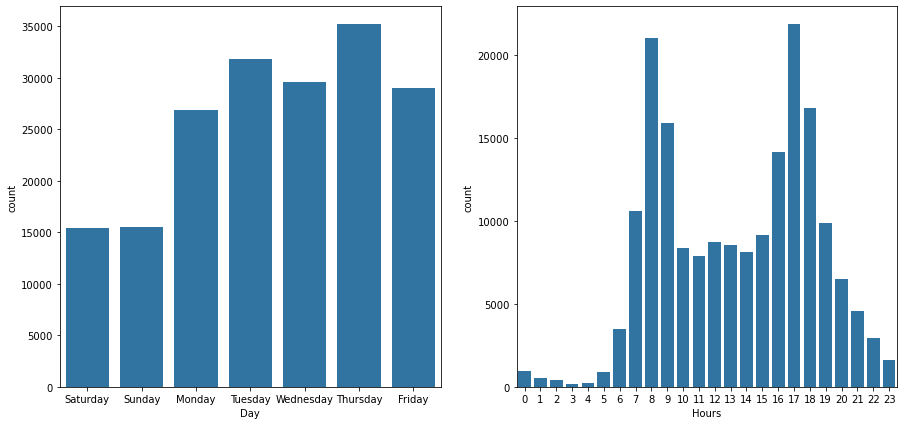

In [4]:
base_color = sb.color_palette()[0]

plt.figure(figsize=[15, 7])
plt.subplot(1, 2, 1)

weeks = ['Saturday', 'Sunday', 'Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday']
sb.countplot(data = df, x='day', color = base_color, order = weeks);
plt.xlabel('Day');

plt.subplot(1, 2, 2)
sb.countplot(data = df, x='time_of_day', color = base_color);
plt.xlabel('Hours');

## Relation between User Type, Trip Duration, and Users' Age

- In general, Customers spends more time in their bike trips more than subscribers.
- The majority of older users are Subscribers and they spend little time in their bike trips.
- Younger Customers trip duration is slightly more than younger subscribers.

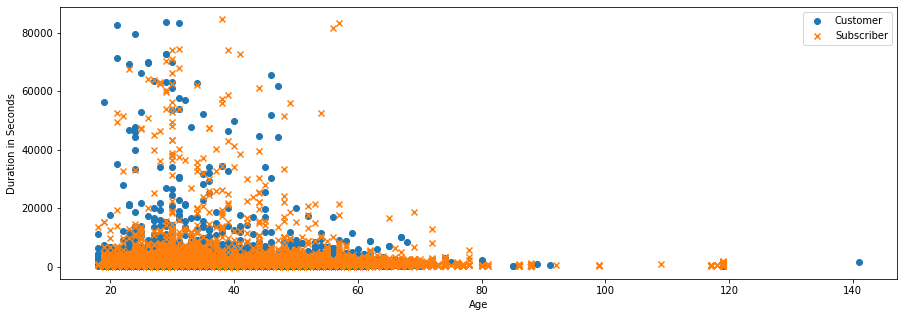

In [5]:
plt.figure(figsize = [15, 5]);
user_type_markers = [['Customer', 'o'],
               ['Subscriber', 'x']]

for cat, marker in user_type_markers:
    df_cat = df[df['user_type'] == cat]
    plt.scatter(data = df_cat, x = 'age', y = 'duration_sec', marker = marker);
    
plt.legend(['Customer','Subscriber']);
plt.xlabel('Age');
plt.ylabel('Duration in Seconds');

## Relation between Users' Gender, Trip Duration, and Users' Age

- In general, Female users average bike trip duration is slightly more than male users.
- The majority of older users are male users and they spend little time in their bike trips.
- Younger male users' trip duration is slightly more than the younger users of other genders.

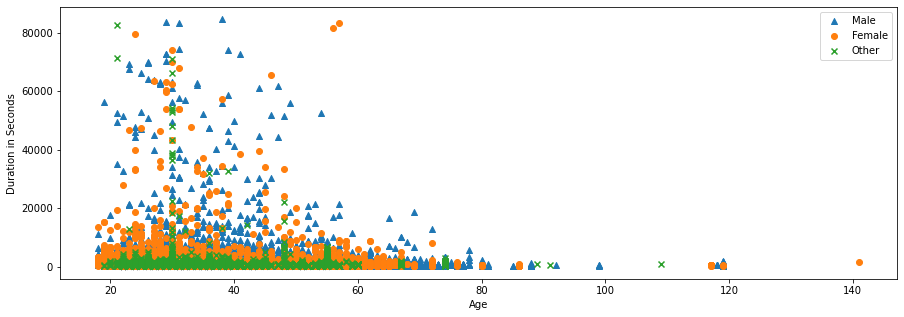

In [6]:
plt.figure(figsize = [15, 5]);
user_type_markers = [['Male', '^'], ['Female', 'o'], ['Other', 'x']]

for cat, marker in user_type_markers:
    df_cat = df[df['member_gender'] == cat]
    plt.scatter(data = df_cat, x = 'age', y = 'duration_sec', marker = marker);

plt.legend(['Male', 'Female', 'Other']);
plt.xlabel('Age');
plt.ylabel('Duration in Seconds');

## Summary of Findings
- The dataset contains many males than females, and more subscribers than customers.
- Users tends to take bike trips more on Thursday, then Tuesday, then Wednesday. On the weekend the number of trips is roughly the same on Saturdays and Sundays. That is normal which may indicate that users take bikes for trips during working days.
- Most trips takes place between 7 - 9 AM and at 4 - 6 PM. Obviously, There are not many trips from 12 AM to 5 AM.

- People who are between 20 and 40 years old tends to take more time in there trips.
- Customers spends more time in their bike trips more than subscribers.
- Female users average bike trip duration is slightly more than male users.

- The majority of older users are male users and they spend little time in their bike trips.
- The majority of older users are Subscribers and they spend little time in their bike trips.
- Younger male users' trip duration is slightly more than the younger users of other genders.
- Younger Customers trip duration is slightly more than younger subscribers.

> Once you're ready to finish your presentation, check your output by using
nbconvert to export the notebook and set up a server for the slides. From the
terminal or command line, use the following expression:
> > `jupyter nbconvert <file_name>.ipynb --to slides --post serve --template output_toggle`

> This should open a tab in your web browser where you can scroll through your
presentation. Sub-slides can be accessed by pressing 'down' when viewing its parent
slide. Make sure you remove all of the quote-formatted guide notes like this one
before you finish your presentation!